# Lab No 4: Geovisualization II - Apps

# Challenge 1

QUESTION 3:
For Edinburgh: Comparing the population sum to the number of nodes in the city. The scatterplot that this generates finds that there is a moderate positive corelation between these two variables, with areas with higher populations also generally having a higher node count. This could be reflective of the greater number of services and buildings that are needed when there is a higher number of people living there. In the grid map that is generatated, you can see where the urban centre is located as there is a higher number of nodes in this area, which then gradually reduces with distance to the centre.

For Boston: when comparing population sum and number of nodes, there is a strong positive corelation shown in the scatterplot. There is a large cluster of points with a low population and also low node point. On the other end of the specturm Dorchester appears to have both a very high node count and population, potentially reflecting a more dense urban area. 

Both cities follow a similar linear patern of high population count associated with high node count.

QUESTION 4:
You may make assumptions based on some of the linear relationships shown. While there may be a correlation between the variables, this does not necessarily imply causation and a relationship may be incorrectly assumed. 


It does not take into account the capacity or the quality of some of the buildings and services as well as additional social factors that shape the functioning of the urban area. Relationships between variables and any information inferred should be grounded in the context and information about that city that is vital for understanding the challenges it faces.


This approach also assumes that each variable is independent. However, cities are complex and many of the variables are likely to be interconnected, with changes to one having implications on another. This is not always represented in the visual displays generated in Urbanity. Care should be taken before assuming there is a linear relationship. 

# Challenge 2

Link to dashboard: https://www.arcgis.com/apps/dashboards/5d7eda34433f4b30920a0a9cb9745d44

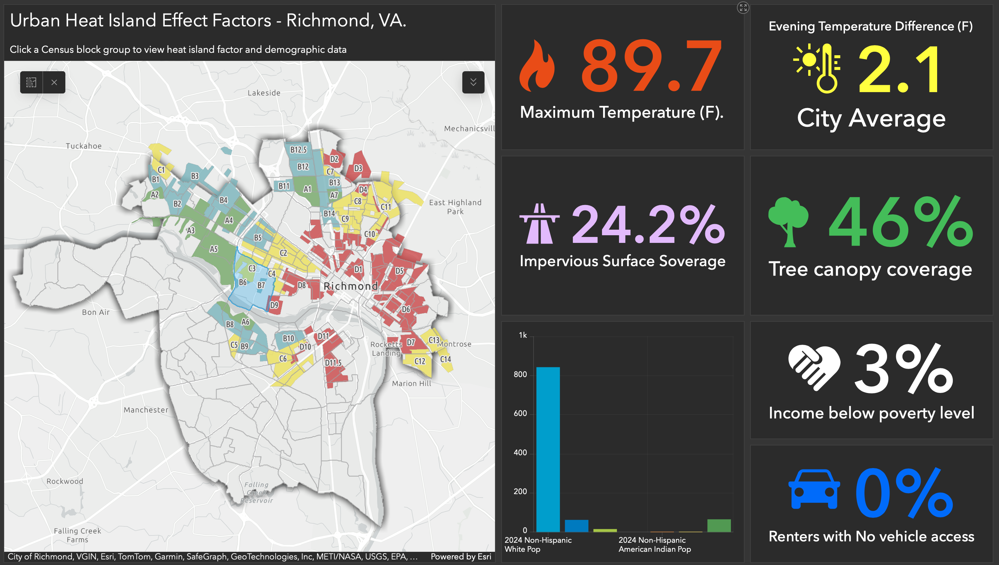


# Challenge 3

In [3]:
#cd 

/Users/milliemccallum/Documents/UA2


In [4]:
# Upload the data and read it as a gdf

import mapclassify as mc
import matplotlib.pyplot as plt
import folium
import seaborn as sns
import geopandas as gpd
import pandas as pd 

shapefile_path = 'Data/data_lab4/SG_SIMD_2020/SG_SIMD_2020.shp'
simd = gpd.read_file(shapefile_path)
simd.head()

,DataZone,DZName,LAName,SAPE2017,WAPE2017,Rankv2,Quintilev2,Decilev2,Vigintilv2,Percentv2,...,CrimeRate,CrimeRank,HouseNumOC,HouseNumNC,HouseOCrat,HouseNCrat,HouseRank,Shape_Leng,Shape_Area,geometry
0,S01006506,Culter - 01,Aberdeen City,894,580,4691,4,7,14,68,...,125,4664.0,87,10,10%,1%,3248.0,11801.872345,4.388802e+06,"POLYGON ((383285.265 800510.607, 383348.492 80..."
1,S01006507,Culter - 02,Aberdeen City,793,470,4862,4,7,14,70,...,128,4602.0,85,4,10%,0%,3486.0,2900.406362,2.217468e+05,"POLYGON ((383527.919 801536.276, 383541.089 80..."
2,S01006508,Culter - 03,Aberdeen City,624,461,5686,5,9,17,82,...,130,4563.5,31,8,5%,1%,5342.0,3468.761949,2.701948e+05,"POLYGON ((383473.000 801227.000, 383597.000 80..."
3,S01006509,Culter - 04,Aberdeen City,537,307,4332,4,7,13,63,...,75,5626.0,42,6,7%,1%,4394.5,1647.461389,9.625426e+04,"POLYGON ((383976.659 801182.579, 383984.102 80..."
4,S01006510,Culter - 05,Aberdeen City,663,415,3913,3,6,12,57,...,168,3885.0,50,7,9%,1%,3736.0,3026.111412,1.800766e+05,"POLYGON ((384339.000 801211.000, 384316.510 80..."


In [5]:
# filter so it only includes results for the City of Edinburgh 

simd_edin = simd.loc[(simd['LAName']=='City of Edinburgh')]

simd_edin.head()

,DataZone,DZName,LAName,SAPE2017,WAPE2017,Rankv2,Quintilev2,Decilev2,Vigintilv2,Percentv2,...,CrimeRate,CrimeRank,HouseNumOC,HouseNumNC,HouseOCrat,HouseNCrat,HouseRank,Shape_Leng,Shape_Area,geometry
1911,S01008417,Balerno and Bonnington Village - 01,City of Edinburgh,708,397,5537,4,8,16,80,...,86,5392.0,17,8,2%,1%,6350.0,20191.721420,1.029993e+07,"POLYGON ((315157.369 666212.846, 315173.727 66..."
1912,S01008418,Balerno and Bonnington Village - 02,City of Edinburgh,691,378,6119,5,9,18,88,...,103,5063.0,7,10,1%,1%,6650.0,25944.861787,2.357050e+07,"POLYGON ((317816.000 666579.000, 318243.000 66..."
1913,S01008419,Balerno and Bonnington Village - 03,City of Edinburgh,541,338,5200,4,8,15,75,...,187,3594.0,30,0,6%,0%,5372.5,5738.935106,1.366457e+06,"POLYGON ((316831.000 667049.000, 316816.000 66..."
1914,S01008420,Balerno and Bonnington Village - 04,City of Edinburgh,466,274,6431,5,10,19,93,...,109,4957.0,2,0,0%,0%,6957.0,1890.096713,1.051967e+05,"POLYGON ((316368.000 666124.000, 316379.297 66..."
1915,S01008421,Balerno and Bonnington Village - 05,City of Edinburgh,884,537,3441,3,5,10,50,...,264,2575.0,61,6,7%,1%,4598.0,2645.609037,1.465441e+05,"POLYGON ((316411.427 666596.771, 316422.940 66..."


In [6]:
# copy the subset to prevent errors later

simd_edi = simd_edin.copy()

In [7]:
simd_edi.columns
# choosing column to work with: I am going to select "EduNoQuals" or Working age people with no qualifications

Index(['DataZone', 'DZName', 'LAName', 'SAPE2017', 'WAPE2017', 'Rankv2',
       'Quintilev2', 'Decilev2', 'Vigintilv2', 'Percentv2', 'IncRate',
       'IncNumDep', 'IncRankv2', 'EmpRate', 'EmpNumDep', 'EmpRank', 'HlthCIF',
       'HlthAlcSR', 'HlthDrugSR', 'HlthSMR', 'HlthDprsPc', 'HlthLBWTPc',
       'HlthEmergS', 'HlthRank', 'EduAttend', 'EduAttain', 'EduNoQuals',
       'EduPartici', 'EduUniver', 'EduRank', 'GAccPetrol', 'GAccDTGP',
       'GAccDTPost', 'GAccDTPsch', 'GAccDTSsch', 'GAccDTRet', 'GAccPTGP',
       'GAccPTPost', 'GAccPTRet', 'GAccBrdbnd', 'GAccRank', 'CrimeCount',
       'CrimeRate', 'CrimeRank', 'HouseNumOC', 'HouseNumNC', 'HouseOCrat',
       'HouseNCrat', 'HouseRank', 'Shape_Leng', 'Shape_Area', 'geometry'],
      dtype='object')

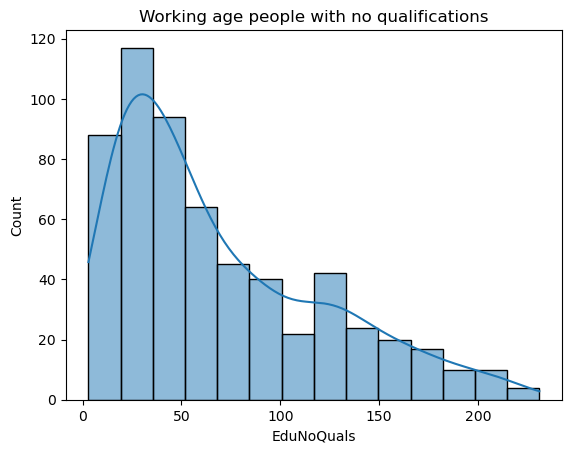

In [8]:
# Create a histogram of the EduNoQuals data

sns.histplot(data=simd_edi, x="EduNoQuals", kde=True)
plt.title("Working age people with no qualifications")
plt.show()

In [9]:
# create two classifiers for natural breaks and equal interval classification 

num_classes = 6

# For Natural breaks classification
classifier_nb = mc.NaturalBreaks(simd_edi['EduNoQuals'], k=num_classes)
print(classifier_nb)
print(min(classifier_nb.bins), max(classifier_nb.bins))
print(classifier_nb.bins)

# for equal interval classification 

classifier_ei = mc.EqualInterval(simd_edi['EduNoQuals'], k=num_classes)
print(classifier_ei)
print(min(classifier_ei.bins), max(classifier_ei.bins))
print(classifier_ei.bins)
                                 
                     

NaturalBreaks

    Interval       Count
------------------------
[  3.00,  34.00] |   199
( 34.00,  65.00] |   155
( 65.00, 101.00] |    96
(101.00, 137.00] |    68
(137.00, 173.00] |    49
(173.00, 231.00] |    30
34.0 231.0
[ 34.  65. 101. 137. 173. 231.]
EqualInterval

    Interval       Count
------------------------
[  3.00,  41.00] |   241
( 41.00,  79.00] |   153
( 79.00, 117.00] |    81
(117.00, 155.00] |    70
(155.00, 193.00] |    35
(193.00, 231.00] |    17
41.0 231.0
[ 41.  79. 117. 155. 193. 231.]


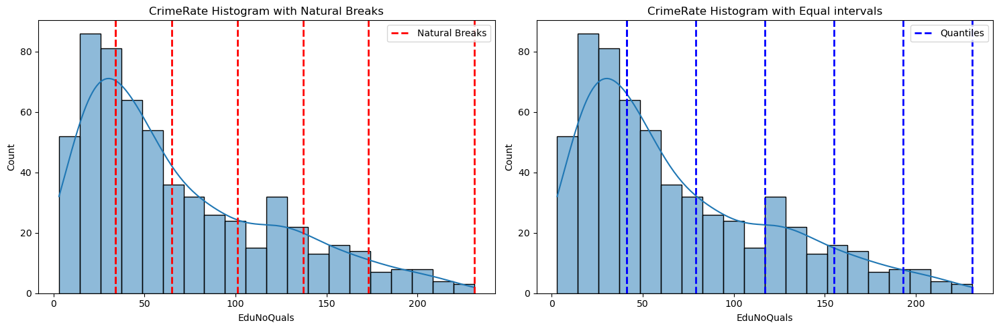

In [10]:
# plotting two histograms to visually represent differences in classification

#histogram for natural breaks 
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
sns.histplot(data=simd_edi, x="EduNoQuals", ax=axes[0], kde=True, bins=20)
axes[0].axvline(classifier_nb.bins[0], color='red', linestyle='dashed', linewidth=2, label='Natural Breaks')
for bin_value in classifier_nb.bins:
    axes[0].axvline(bin_value, color='red', linestyle='dashed', linewidth=2)
axes[0].set_title("CrimeRate Histogram with Natural Breaks")
axes[0].legend()

# histogram for equal interval 
sns.histplot(data=simd_edi, x="EduNoQuals", ax=axes[1], kde=True, bins=20)
axes[1].axvline(classifier_ei.bins[0], color='blue', linestyle='dashed', linewidth=2, label='Quantiles')
for bin_value in classifier_ei.bins:
    axes[1].axvline(bin_value, color='blue', linestyle='dashed', linewidth=2)
axes[1].set_title("CrimeRate Histogram with Equal intervals")
axes[1].legend()

plt.tight_layout()
plt.show()

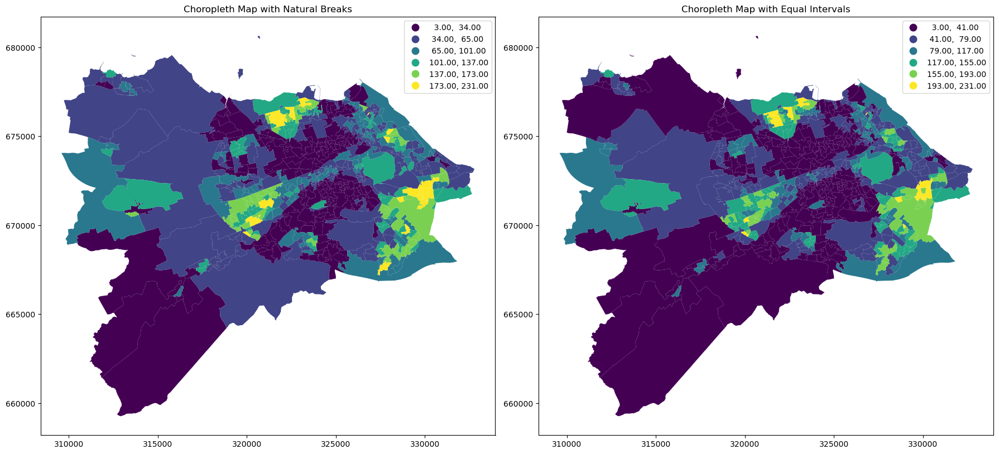

In [11]:
# create choropleth maps to visualise this difference

fig, axs = plt.subplots(1, 2, figsize=(18, 8))

simd_edi.plot(column='EduNoQuals', ax=axs[0],
         legend=True, cmap='viridis',
         scheme='UserDefined',
         classification_kwds={'bins': classifier_nb.bins}
        )

axs[0].set_title("Choropleth Map with Natural Breaks")

simd_edi.plot(column='EduNoQuals', ax=axs[1],
         legend=True, cmap='viridis',
         scheme='UserDefined',
         classification_kwds={'bins': classifier_ei.bins})

axs[1].set_title("Choropleth Map with Equal Intervals")

plt.tight_layout() 
plt.show()

As you can see on the above plot, using natural breaks as a classification method visually displays a larger number of areas with slightly lower levels of working age people without qualifications than when using equal intervals. This is especially apparent for the suburbs to the West of Edinburgh. The equal interval classification has a higher proportion of areas with the highest classification, however, the natural breaks classification includes more areas in the lowest classification 

I am going to use the natural breaks classification as it highlights differences in the dataset with greater clarity

In [19]:
# uploading the gdf of the Glasgow SIMD

import plotly.express as px
import geopandas as gpd

shapefile_path = 'Data/data_lab4/SIMD_2020_GlasgowCity.shp'
gdf = gpd.read_file(shapefile_path)

In [15]:
gdf.set_index('DataZone', inplace=True)
gdf.head()

,DZName,LAName,SAPE2017,WAPE2017,Rankv2,Quintilev2,Decilev2,Vigintilv2,Percentv2,IncRate,...,CrimeRate,CrimeRank,HouseNumOC,HouseNumNC,HouseOCrat,HouseNCrat,HouseRank,Shape_Leng,Shape_Area,geometry
DataZone,,,,,,,,,,,,,,,,,,,,,
S01009758,Darnley East - 01,Glasgow City,624,407,4997,4,8,15,72,3%,...,81,5523.0,73,43,13%,8%,1021.0,1474.152028,78490.309008,"POLYGON ((-4.32476 55.79910, -4.32574 55.79840..."
S01009759,Darnley East - 02,Glasgow City,860,570,161,1,1,1,3,45%,...,561,791.0,223,29,24%,3%,494.0,2170.701472,136091.515542,"POLYGON ((-4.32823 55.81192, -4.32837 55.81166..."
S01009760,Darnley East - 03,Glasgow City,852,550,998,1,2,3,15,23%,...,318,2079.0,173,8,19%,1%,1157.0,3057.747139,332345.088422,"POLYGON ((-4.32429 55.80524, -4.32408 55.80505..."
S01009761,Darnley East - 04,Glasgow City,846,558,3135,3,5,9,45,13%,...,83,5459.0,122,24,13%,3%,1878.0,2761.244322,156078.015080,"POLYGON ((-4.32934 55.80065, -4.32952 55.80036..."
S01009762,Darnley East - 05,Glasgow City,1183,801,1247,1,2,4,18,25%,...,340,1904.0,201,6,22%,1%,870.0,2295.018993,150737.851165,"POLYGON ((-4.33150 55.80660, -4.33145 55.80649..."


In [16]:
# check the crs of each gdf matches 

print(gdf.crs)
print(simd_edi.crs)


EPSG:4326
EPSG:4326


In [17]:
# change the crs of edinburgh gdf to match that of glasgow

simd_edi = simd_edi.to_crs('EPSG:4326')

In [23]:
# creating the classification for Glasgow EduNoQuals

num_classes = 5

classifier_nb_gla = mc.NaturalBreaks(gdf['EduNoQuals'], k=num_classes)
gdf['classification_nb_gla'] = classifier_nb_gla.yb #yb to get the values from the array.

print(classifier_nb_gla)
print(gdf[['EduNoQuals', 'classification_nb_gla']])

NaturalBreaks

    Interval       Count
------------------------
[ 11.00,  72.00] |   136
( 72.00, 127.00] |   168
(127.00, 179.00] |   144
(179.00, 231.00] |   195
(231.00, 353.00] |   103
     EduNoQuals  classification_nb_gla
0           100                      1
1           202                      3
2           205                      3
3           147                      2
4           219                      3
..          ...                    ...
741         276                      4
742         238                      4
743         187                      3
744         195                      3
745         222                      3

[746 rows x 2 columns]


In [24]:
import plotly.express as px

# create an interactive plot for glasgow EduNoQuals

fig = px.choropleth_mapbox(gdf,
                           geojson=gdf.geometry,
                           locations=gdf.index,
                           color="classification_nb_gla",
                           color_continuous_scale="viridis",
                           range_color= (1, 5),
                           opacity=0.5,
                           center={"lat": 55.866193, "lon": -4.258246},
                           mapbox_style="carto-positron",
                           zoom=9.5)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

/var/folders/d1/m4w3nsnj6k5_lmftsj71l4j40000gn/T/ipykernel_7136/2327450273.py:5: DeprecationWarning:

*choropleth_mapbox* is deprecated! Use *choropleth_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



In [25]:
# create the classifications for Edi EduNoQuals
num_classes = 5

classifier_nb_edi = mc.NaturalBreaks(simd_edi['EduNoQuals'], k=num_classes)
simd_edi['classification_nb_edi'] = classifier_nb_edi.yb #yb to get the values from the array.

print(classifier_nb_edi)
print(simd_edi[['EduNoQuals', 'classification_nb_edi']])

NaturalBreaks

    Interval       Count
------------------------
[  3.00,  34.00] |   199
( 34.00,  65.00] |   155
( 65.00, 106.00] |   102
(106.00, 158.00] |    94
(158.00, 231.00] |    47
      EduNoQuals  classification_nb_edi
1911          28                      0
1912          24                      0
1913          34                      0
1914          30                      0
1915          88                      2
...          ...                    ...
2503         118                      3
2504          38                      1
2505          30                      0
2506          28                      0
2507          52                      1

[597 rows x 2 columns]


In [22]:
# create an interactive plot for edinburgh EduNoQuals

fig = px.choropleth_mapbox(simd_edi,
                           geojson=simd_edi.geometry,
                           locations=simd_edi.index,
                           color="classification_nb_edi",
                           color_continuous_scale="viridis",
                           range_color= (1, 5),
                           opacity=0.5,
                           center={"lat": 55.953252, "lon": -3.188267},
                           mapbox_style="carto-positron",
                           zoom=9.5)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

/var/folders/d1/m4w3nsnj6k5_lmftsj71l4j40000gn/T/ipykernel_7136/3812433001.py:3: DeprecationWarning: *choropleth_mapbox* is deprecated! Use *choropleth_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/
  fig = px.choropleth_mapbox(simd_edi,


By comparing these two choropleth maps, it is clear that there are a larger number of areas in Glasgow that have a higher number of working age adults with no qualifications. There are also clear differences between the rates at the centre of each city, with Edinburgh's centre on the whole having the lowest categorisation for working age adults with no qualifications, compared to Glasgow which has much higher classifica